In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import punch_party_utils

Let's view the first few columns of each dataframe to see what we are working with

In [2]:
gas_types = punch_party_utils.make_gas_types_df(silent=False)

gas_types.head():
        Address Line 1        City  CO2 Emission      County  Facility ID  \
0     1919 S. BROADWAY   GREEN BAY     58024.000       BROWN      1000589   
1         850 12TH AVE    NEW YORK       134.500         NEW      1000766   
2         3379 HWY 482       NOBLE         6.854      SABINE      1009343   
3    1012 BEAUCHAMP ST  GREENVILLE     53562.000  WASHINGTON      1003557   
4  487 CORN CREEK ROAD     BEDFORD   7635064.700     TRIMBLE      1006542   

  Gas Code        Gas Name   Latitude  Longitude   State Name  Year  Zip Code  \
0   BIOCO2    BIOGENIC CO2  44.492500 -88.032300    WISCONSIN  2017     54304   
1      CH4         METHANE  40.771100 -73.991100     NEW YORK  2018     10019   
2      N2O   NITROUS OXIDE  31.621528 -93.724774    LOUISIANA  2012     71462   
3      CH4         METHANE  33.392476 -91.017584  MISSISSIPPI  2017     38701   
4      CO2  CARBON DIOXIDE  38.584700 -85.411700     KENTUCKY  2018     40006   

                                

The gas_type dataframe contains data about the location of emitter facilities and gas types emitted from each one. There are ~220,000 entries.

In [3]:
air_quality = punch_party_utils.make_air_quality_df(silent=False)

air_quality.head():


The air_quality dataframe contains air quality measures across different states/counties in the United States. It contains over 218,000 entries.

In [4]:
facilities = punch_party_utils.make_facilities_df()

/home/sean/msse/data200S/TeamPunchParty/punch_party_utils.py:19: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  facilities_df = pd.read_csv(filename)


The facilities dataframe contains data about each facility, namely address, location, and IDs (FIPS, NAICS). There are ~77,000 rows.

# Question a 
## How does air quality relate to the number of emitting facilities and and level of emissions in the area?
We can answer this question using the air_quality and gas_types dataframes. There are a few things we need to choose first:
- what year we will use
- which air quality measure type to use

In [6]:
# air quality rows where 'MeasureType' is average

aq_avg = punch_party_utils.make_average_aq_df()

The air quality dataframe has data from the years 1999 - 2013 while gas_types has data from 2010 - 2019. Let's use the year 2011 since both have a good amount of data for this year.

In [6]:
# UNCOMMENT CODE BELOW TO SEE NUM ENTRIES FOR EACH YEAR
#gas_types['Year'].value_counts()
#aq_avg['ReportYear'].value_counts()

Now let's find the number of facilities in a county in a given year and put that data together. Below is a trial run. Following a successful trial run, I put the following code into a for loop to do the same for every state and county in 2011.

In [7]:
# air_quality rows where Weston is the county and year is 2011
weston_aq_2011 = aq_avg[(aq_avg['CountyName'] == 'WESTON') & (aq_avg['ReportYear'] == 2011) & (aq_avg['StateName'] == 'WYOMING')]

# gas_types rows where Weston is county and year is 2011
weston_gas_2011 = gas_types[(gas_types['County'] == 'WESTON') & (gas_types['Year'] == 2011)]
# get number of facilities in that county and year
num_weston_facilities = weston_gas_2011['Facility Name'].nunique()

# add number of facilities column to weston_aq
#weston_aq['NumFacilities'] = num_weston_facilities
weston_aq_and_facilities = weston_aq_2011.assign(NumFacilities= num_weston_facilities)
weston_aq_and_facilities

,MeasureId,MeasureName,MeasureType,StratificationLevel,StateFips,StateName,CountyFips,CountyName,ReportYear,Value,Unit,UnitName,DataOrigin,MonitorOnly,NumFacilities
218634,296,Annual average ambient concentrations of PM 2....,Average,State x County,56,WYOMING,56045,WESTON,2011,6.646464,µg/m³,Micograms per cubic meter,Monitor & Modeled,0,3


## ATTENTION
Do not run the cell below. It takes ~3.5 hours to produce the resulting dataframe. The code remains here for the sake of documentation and its output can be found in the file 'county-airq-num-facilities-with-none.csv'

In [13]:

# create an empty DataFrame to store the results: air quality
county_aq_with_facilities = pd.DataFrame()

# get unique counties and states from the aq_avg
counties = aq_avg['CountyName'].unique()
states = aq_avg['StateName'].unique()

# iterate through each combination of county and state
for county in counties:
    for state in states:
        # filter 'aq_avg' for current county and state in 2011
        county_aq_2011 = aq_avg[(aq_avg['CountyName'] == county) & (aq_avg['StateName'] == state) & (aq_avg['ReportYear'] == 2011)]

        # filter 'gas_types' for the current county and state in 2011
        county_gas_2011 = gas_types[(aq_avg['CountyName'] == county) & (gas_types['State Name'] == state) & (gas_types['Year'] == 2011)]
        # get the number of unique facilities for the current county and state in 2011
        num_facilities = county_gas_2011['Facility Name'].nunique()

        # add number of facilities column to county_aq_data
        county_aq_and_facilities_entry = county_aq_2011.assign(NumFacilities= num_facilities)

        # create a new row for the resulting dataframe with the county, state, and number of facilities
        county_aq_with_facilities = pd.concat([county_aq_with_facilities, county_aq_and_facilities_entry], ignore_index=True)
# Display the result DataFrame
county_aq_with_facilities.head()

/var/folders/m8/skfw9g2x4_g4pq5cv80_g24w0000gn/T/ipykernel_77440/2374596677.py:15: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  county_gas_2011 = gas_types[(aq_avg['CountyName'] == county) & (gas_types['State Name'] == state) & (gas_types['Year'] == 2011)]
/var/folders/m8/skfw9g2x4_g4pq5cv80_g24w0000gn/T/ipykernel_77440/2374596677.py:15: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  county_gas_2011 = gas_types[(aq_avg['CountyName'] == county) & (gas_types['State Name'] == state) & (gas_types['Year'] == 2011)]
/var/folders/m8/skfw9g2x4_g4pq5cv80_g24w0000gn/T/ipykernel_77440/2374596677.py:15: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  county_gas_2011 = gas_types[(aq_avg['CountyName'] == county) & (gas_types['State Name'] == state) & (gas_types['Year'] == 2011)]
/var/folders/m8/skfw9g2x4_g4pq5cv80_g24w0000gn/T/ipykernel_77440/2374596677.py:15: UserWarning: Boolean Series key will be reindex

,MeasureId,MeasureName,MeasureType,StratificationLevel,StateFips,StateName,CountyFips,CountyName,ReportYear,Value,Unit,UnitName,DataOrigin,MonitorOnly,NumFacilities
0,87,Annual average ambient concentrations of PM2.5...,Average,State x County,54,WEST VIRGINIA,54081,RALEIGH,2011,9.170170,µg/m³,Micograms per cubic meter,Monitor Only,1,0
1,296,Annual average ambient concentrations of PM 2....,Average,State x County,54,WEST VIRGINIA,54081,RALEIGH,2011,9.455357,µg/m³,Micograms per cubic meter,Monitor Only,1,0
2,87,Annual average ambient concentrations of PM2.5...,Average,State x County,12,FLORIDA,12033,ESCAMBIA,2011,9.473017,µg/m³,Micograms per cubic meter,Monitor Only,1,0
3,296,Annual average ambient concentrations of PM 2....,Average,State x County,12,FLORIDA,12033,ESCAMBIA,2011,9.611908,µg/m³,Micograms per cubic meter,Monitor Only,1,0
4,296,Annual average ambient concentrations of PM 2....,Average,State x County,1,ALABAMA,1053,ESCAMBIA,2011,9.604895,µg/m³,Micograms per cubic meter,Monitor & Modeled,0,0


In [7]:
# save dataframe to a CSV file. Obviously this cell won't work sinde you didnt run the above cell.
# county_aq_with_facilities.to_csv('county-airq-num-facilities-with-none.csv', index=False)

There are some state/county combos for which we have air quality data but no facility data. NumFacilities is 0 for these states/counties.

In [16]:
county_aq_with_facilities_with_none = pd.read_csv('county-airq-num-facilities-with-none.csv')
county_aq_with_facilities_with_none.head()

print(f'The number of non-zero values in the NumFacilities column is {len(county_aq_with_facilities_with_none) - county_aq_with_facilities_with_none["NumFacilities"].eq(0).sum()}.')

The number of non-zero values in the NumFacilities column is 424.


Of the 3634 rows in county_aq_with_facilities, only 424 of them have non-zero values for NumFacilities. Maybe can use our generative model to predict the number of facilities in some of these places based on air quality value. For now, let's remove these values so we can plot air quality vs num facilities and air quality vs emission value

In [18]:
# county_aq_with_facilities = county_aq_with_facilities_with_none[county_aq_with_facilities_with_none['NumFacilities'] != 0]
# county_aq_with_facilities.head()

# save to CSV as well. This also won't work anymore, but is here to document what was done
#county_aq_with_facilities.to_csv('county-airq-num-facilities.csv', index=False)

The next time this notebook was loaded, county_aq_with_facilities was read from the CSV it was saved to last time

In [19]:
# read from csv to continue working
county_aq_with_facilities = pd.read_csv('county-airq-num-facilities.csv')

county_aq_with_facilities.head()

,MeasureId,MeasureName,MeasureType,StratificationLevel,StateFips,StateName,CountyFips,CountyName,ReportYear,Value,Unit,UnitName,DataOrigin,MonitorOnly,NumFacilities
0,296,Annual average ambient concentrations of PM 2....,Average,State x County,54,WEST VIRGINIA,54037,JEFFERSON,2011,10.382477,µg/m³,Micograms per cubic meter,Monitor & Modeled,0,2
1,296,Annual average ambient concentrations of PM 2....,Average,State x County,29,MISSOURI,29099,JEFFERSON,2011,11.974413,µg/m³,Micograms per cubic meter,Monitor & Modeled,0,1
2,296,Annual average ambient concentrations of PM 2....,Average,State x County,19,IOWA,19101,JEFFERSON,2011,10.343955,µg/m³,Micograms per cubic meter,Monitor & Modeled,0,1
3,87,Annual average ambient concentrations of PM2.5...,Average,State x County,39,OHIO,39081,JEFFERSON,2011,12.602603,µg/m³,Micograms per cubic meter,Monitor Only,1,1
4,296,Annual average ambient concentrations of PM 2....,Average,State x County,39,OHIO,39081,JEFFERSON,2011,12.557897,µg/m³,Micograms per cubic meter,Monitor Only,1,1


Finally, let's make a scatter plot to visualize the relationship between number of facilities and air quality measure values.

/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


<Axes: xlabel='NumFacilities', ylabel='Value'>

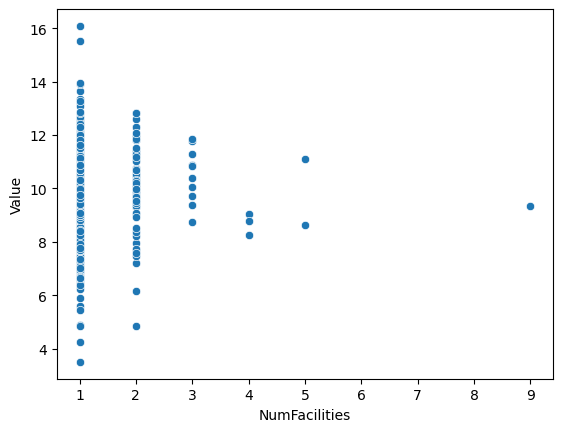

In [20]:
sns.scatterplot(x = "NumFacilities", y = "Value", data=county_aq_with_facilities)

In [22]:
county_aq_with_facilities['StateName'].value_counts()

StateName
OHIO              40
TEXAS             40
ILLINOIS          27
GEORGIA           20
KENTUCKY          19
PENNSYLVANIA      18
NEW YORK          17
MISSOURI          17
LOUISIANA         17
INDIANA           17
IOWA              15
NORTH CAROLINA    13
CALIFORNIA        13
TENNESSEE         13
MICHIGAN          13
ARKANSAS          10
MISSISSIPPI       10
FLORIDA            9
ALABAMA            9
COLORADO           8
VIRGINIA           8
WISCONSIN          8
KANSAS             8
NEW JERSEY         6
WEST VIRGINIA      6
MINNESOTA          6
NEBRASKA           5
SOUTH DAKOTA       5
OKLAHOMA           4
WASHINGTON         4
OREGON             3
SOUTH CAROLINA     3
MAINE              3
NEW HAMPSHIRE      2
DELAWARE           2
NORTH DAKOTA       2
NEVADA             1
NEW MEXICO         1
IDAHO              1
MARYLAND           1
Name: count, dtype: int64

# Question c
## Is there a gas type associated with especially bad AQ measures?
We can answer this question using the air_quality and gas_types dataframes. We will use:
- aq measures from a particular gas type

In [14]:
# air quality rows where 'MeasureType' is average
# we are doing this because other measure types contain a lot of 0s
aq_avg = air_quality[air_quality['MeasureType'] == 'Average']
# rename the county column in aq_avg so they have the same name and merging is easier
aq_avg = aq_avg.rename(columns = {'CountyName': 'County'})

# I'm still suspicious about their modeled values, going monitor only for my model
# print(aq_avg["MeasureName"].unique())

aq_avg_moniter_only = aq_avg[aq_avg["MeasureName"] == "Annual average ambient concentrations of PM2.5 in micrograms per cubic meter (based on seasonal averages and daily measurement)"]

print(aq_avg_moniter_only["ReportYear"].unique())

[2003 2002 1999 2001 2006 2009 2013 2004 2007 2008 2010 2005 2000 2012
 2011]
Index(['MeasureId', 'MeasureName', 'MeasureType', 'StratificationLevel',
       'StateFips', 'StateName', 'CountyFips', 'County', 'ReportYear', 'Value',
       'Unit', 'UnitName', 'DataOrigin', 'MonitorOnly'],
      dtype='object')


The below comment seems wrong: only one of the plots below appears to specify 2011 interest.

The air quality dataframe has data from the years 1999 - 2013 while gas_types has data from 2010 - 2019. Let's use the year 2011 since both have a good amount of data for this year.

In [15]:
print(gas_types.columns)
aq_avg_moniter_only.groupby(["ReportYear, Facility ID"])

Index(['Address Line 1', 'City', 'CO2 Emission', 'County', 'Facility ID',
       'Gas Code', 'Gas Name', 'Latitude', 'Longitude', 'State Name', 'Year',
       'Zip Code', 'Facility Name'],
      dtype='object')


KeyError: 'ReportYear, Facility ID'

In [25]:
# UNCOMMENT CODE BELOW TO SEE NUM ENTRIES FOR EACH YEAR
#gas_types['Year'].value_counts()
#aq_avg['ReportYear'].value_counts()

Let's merge both dataframes based on County so we get a dataframe with both gas codes and aq values (fingers crossed)

In [26]:
gas_types_aq_avg_merged = pd.merge(gas_types, aq_avg, on='County')
gas_types_aq_avg_merged.tail()

,Address Line 1,City,CO2 Emission,County,Facility ID,Gas Code,Gas Name,Latitude,Longitude,State Name,...,StratificationLevel,StateFips,StateName,CountyFips,ReportYear,Value,Unit,UnitName,DataOrigin,MonitorOnly
12756642,5444 HWY 421,HELTON,18101.5,LESLIE,1006623,CH4,METHANE,36.982299,-83.400436,KENTUCKY,...,State x County,21,KENTUCKY,21131,2007,13.248120,µg/m³,Micograms per cubic meter,Monitor & Modeled,0
12756643,5444 HWY 421,HELTON,18101.5,LESLIE,1006623,CH4,METHANE,36.982299,-83.400436,KENTUCKY,...,State x County,21,KENTUCKY,21131,2008,11.158683,µg/m³,Micograms per cubic meter,Monitor & Modeled,0
12756644,5444 HWY 421,HELTON,18101.5,LESLIE,1006623,CH4,METHANE,36.982299,-83.400436,KENTUCKY,...,State x County,21,KENTUCKY,21131,2009,9.942045,µg/m³,Micograms per cubic meter,Monitor & Modeled,0
12756645,5444 HWY 421,HELTON,18101.5,LESLIE,1006623,CH4,METHANE,36.982299,-83.400436,KENTUCKY,...,State x County,21,KENTUCKY,21131,2010,11.145043,µg/m³,Micograms per cubic meter,Monitor & Modeled,0
12756646,5444 HWY 421,HELTON,18101.5,LESLIE,1006623,CH4,METHANE,36.982299,-83.400436,KENTUCKY,...,State x County,21,KENTUCKY,21131,2011,9.516099,µg/m³,Micograms per cubic meter,Monitor & Modeled,0


Nice! Now let's plot Values VS Gas Codes on a scatterplot to visualize any correlation between the two.

/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


<Axes: xlabel='Gas Code', ylabel='Value'>

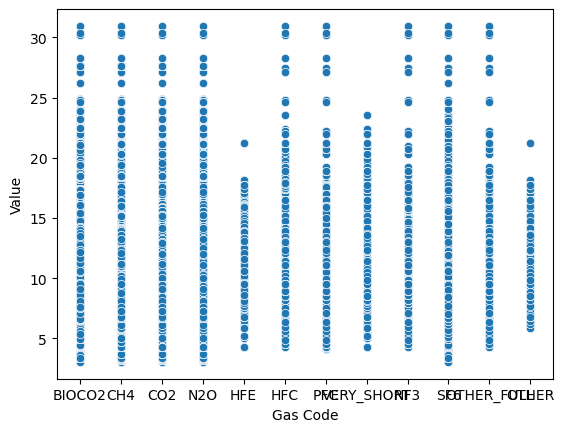

In [28]:
sns.scatterplot(x = "Gas Code", y = "Value", data=gas_types_aq_avg_merged)

Visually, the scatterplot does not show much correlation between a specific gas type and air quality values. Another way to do this would be to groupby gas type and get the average air quality value.

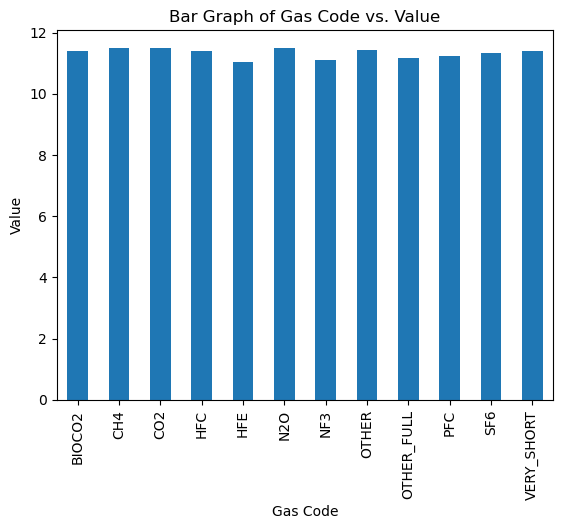

In [29]:
avg_value_by_gas_code = gas_types_aq_avg_merged.groupby('Gas Code')['Value'].mean()
# now we make bar graph
avg_value_by_gas_code.plot.bar(use_index=True)

plt.title('Bar Graph of Gas Code vs. Value')
plt.xlabel('Gas Code')
plt.ylabel('Value')
plt.show()

Average values are all around the same thing. There doesn't seem to be a correlation between an air quality value and a gas type. Tbh this question seems kinda weak (or seems like it'll be too hard to extract the data in a way that will correctly answer the question)

Now plot CO2 emission VS aq measure

/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


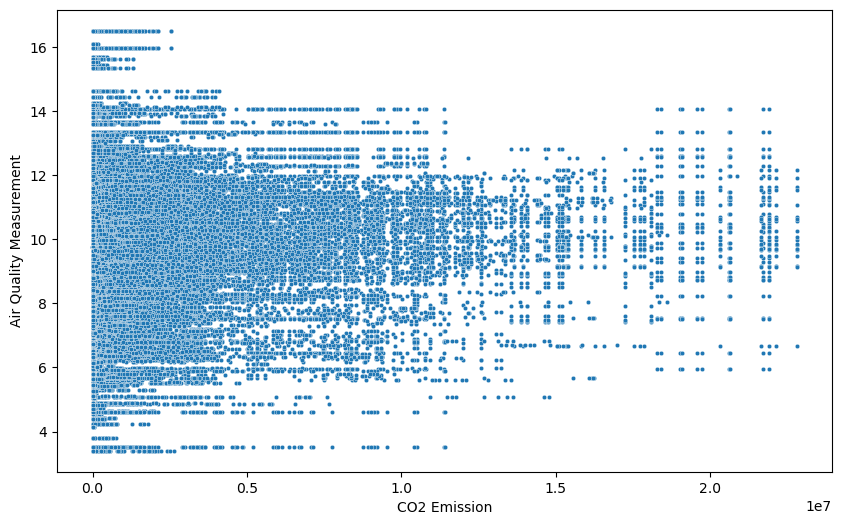

In [32]:
plt.figure(figsize=(10, 6))
gas_types_aq_avg_2011 = gas_types_aq_avg_merged[gas_types_aq_avg_merged['ReportYear'] == 2011]

sns.scatterplot(x = "CO2 Emission", y = "Value", data=gas_types_aq_avg_2011, s=10)

plt.xlabel("CO2 Emission")
plt.ylabel("Air Quality Measurement")
# plt.title("Scatterplot of CO2 Emission vs. AQ Value")
plt.show()